In [1]:
%load_ext autoreload
%autoreload 2

import os
from pathlib import Path
import numpy as np


# Override/set credentials in env var
os.environ['CWD'] = str(Path(os.getcwd()).parent)

# Base paths
cwd = Path(os.environ['CWD'])
dir_data = cwd / 'data'

import plotly.io as pio
pio.renderers.default='notebook'

from tqdm import tqdm 
tqdm.pandas()

In [2]:
import author_classification
author_classification.__version__

'1.0.0'

In [3]:
import pandas as pd

df_tr_ev = pd.read_csv(dir_data / 'train.csv')
df_tr_ev['split'] = 'tr'
df_te = pd.read_csv(dir_data / 'test.csv')
df_te['split'] = 'te'

df = pd.concat([df_tr_ev, df_te])

# Exploratory Data Analysis

## What is the shape of the data?

In [4]:
df.shape

(41000, 4)

In [5]:
df.sample(4)

,Unnamed: 0,text,author,split
11706,11706,He added that he did\nnot pretend to say what...,dickens,tr
18369,18369,"’\n\nI had nothing better to offer, than anoth...",dickens,tr
17621,17621,The hopes I have been encouraged to form tha...,dickens,tr
1874,1874,") Those who are\nunkind, haughty, and imperiou...",defoe,tr


It looks like the data only consists in an index, the passage text and the author to whom this passage pertains to

## Number of different authors and distribution

How many different authors are there?

In [6]:
df_tr_ev['author'].unique()

array(['defoe', 'dickens', 'doyle', 'twain'], dtype=object)

Is the dataset imbalanced?

In [7]:
import plotly.express as px
px.bar(df_tr_ev['author'].value_counts(), width=400, height=400)

The dataset is perfectly balanced. Let's see some statistics per author.

To get statistics per author (e.g. mean number of tokens, word rates, etc.) we need to preprocess the text

# Text preprocessing

Let's take a look at some samples to decide what pre-processing we'll do

In [8]:
df_samples = df_tr_ev.groupby('author').sample(3, random_state=288)
with pd.option_context('display.max_colwidth', None):
    display(df_samples)

,Unnamed: 0,text,author,split
1956,1956,"_The\nExplanation of the Word_ Keys, 25. _The Pyrates conceal their Booty on\nthem_, ib. _The Plunderers turn Pyrates_, 29. _The_\nSpaniards _make Reprisals_, ib. _The Names of Ships taken by them_, ib",defoe,tr
2152,2152,"Then I called him into the cabin, and told him the story;\nand we called in the men, and they told us the rest of it; but as it took\nup a great deal of time, before we had done a seaman comes to the cabin\ndoor, and called out to us that the captain bade him tell us we were\nchased by five sloops, or boats, full of men",defoe,tr
8934,8934,"The actual\nloss of time and of money incurred by such courses of conduct, is\ngenerally of less consequence than the losses arising from habitual\ndistraction of mind, and the acquisition of an acquaintanceship with a\nset of idle or silly companions",defoe,tr
10674,10674,"But he thought it better not to ask\nthe question; and walked back to the shop: thinking over all he had\nseen and heard. \n\n\n\n\n CHAPTER VI. \nOLIVER, BEING GOADED BY THE TAUNTS OF NOAH, ROUSES INTO ACTION, AND\nRATHER ASTONISHES HIM\n\n\nThe month’s trial over, Oliver was formally apprenticed",dickens,tr
13372,13372,"‘Hold up,\nSir!’\n\nThis last observation of Mr. Weller’s bore reference to a demonstration\nMr. Winkle made at the instant, of a frantic desire to throw his feet in\nthe air, and dash the back of his head on the ice",dickens,tr
15799,15799,"\n\n‘Ah,’ said Mr. John Smauker, ‘you disliked the killibeate taste,\nperhaps?’\n\n‘I don’t know much about that ‘ere,’ said Sam. ‘I thought they’d a wery\nstrong flavour o’ warm flat irons. ’\n\n‘That _is_ the killibeate, Mr",dickens,tr
26411,26411,"\n\n “It was very essential for Stapleton to get some article of Sir\n Henry’s attire so that, in case he was driven to use the dog, he\n might always have the means of setting him upon his track",doyle,tr
27370,27370,"It never recovered from the blow, and much of\n my capital was irretrievably swallowed up. And yet, if it were\n not for the loss of the charming companionship of the boys, I\n could rejoice over my own misfortune, for, with my strong tastes\n for botany and zoology, I find an unlimited field of work here,\n and my sister is as devoted to Nature as I am",doyle,tr
29594,29594,"As we reached it the fog was lifting,\nand a thin, watery sunshine was breaking through. A butler answered our\nring. \n\n“Sir James, sir!” said he with solemn face. ”\n\nWe were ushered into a dim-lit drawing-room, where an instant later we\nwere joined by a very tall, handsome, light-bearded man of fifty, the\nyounger brother of the dead scientist",doyle,tr
30032,30032,"In one was my piece of money, in the other lay four silver\ngroschen. She gazed a little while, perhaps to see if the groschen would\nvanish away; then she said, fervently:\n\n“It's true--it's true--and I'm ashamed and beg forgiveness, O dear\nmaster and benefactor!” And she ran to Satan and kissed his hand, over\nand over again, according to the Austrian custom",twain,tr


It looks like the text has a lot of special punctuation for quotations.

Counting these punctuations in each text might be a good feature because some authors might be more prone of having a specific writting style that uses more punctuations.

Anyway, to analyze the distribution of words per author, we need to preprocess the text and eliminate all the quotes, signs, etc. and leave only the pure tokens.

Also, for the analysis of the distribution of works to be the most precise as possible, we will lemmatize the words before preprocessing them.

In [9]:
# Preprocess text
from author_classification.preprocessing import preprocess_text
# We should also make another column
df_tr_ev['text_processed'] = df_tr_ev['text'].progress_apply(lambda txt: preprocess_text(txt, lemmatize=True))

2022-04-27 12:43:23.284135: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-04-27 12:43:23.284175: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
100%|██████████| 40000/40000 [03:08<00:00, 212.15it/s]


In [10]:
# Show some examples' results
df_samples = df_tr_ev.groupby('author').sample(1, random_state=288)
with pd.option_context('display.max_colwidth', None):
    display(df_samples[['text', 'text_processed']])

,text,text_processed
1956,"_The\nExplanation of the Word_ Keys, 25. _The Pyrates conceal their Booty on\nthem_, ib. _The Plunderers turn Pyrates_, 29. _The_\nSpaniards _make Reprisals_, ib. _The Names of Ships taken by them_, ib",explanation word keys 25 pyrates conceal booty ib plunderer turn pyrates 29 spaniard make reprisals ib names ships take ib
10674,"But he thought it better not to ask\nthe question; and walked back to the shop: thinking over all he had\nseen and heard. \n\n\n\n\n CHAPTER VI. \nOLIVER, BEING GOADED BY THE TAUNTS OF NOAH, ROUSES INTO ACTION, AND\nRATHER ASTONISHES HIM\n\n\nThe month’s trial over, Oliver was formally apprenticed",think well ask question walk back shop think see hear chapter vi oliver goaded taunt noah rous action rather astonishes month trial oliver formally apprentice
26411,"\n\n “It was very essential for Stapleton to get some article of Sir\n Henry’s attire so that, in case he was driven to use the dog, he\n might always have the means of setting him upon his track",essential stapleton get article sir henry attire case drive use dog might always mean set upon track
30032,"In one was my piece of money, in the other lay four silver\ngroschen. She gazed a little while, perhaps to see if the groschen would\nvanish away; then she said, fervently:\n\n“It's true--it's true--and I'm ashamed and beg forgiveness, O dear\nmaster and benefactor!” And she ran to Satan and kissed his hand, over\nand over again, according to the Austrian custom",one piece money lie four silver groschen gaze little perhaps see groschen would vanish away say fervently true true ashamed beg forgiveness dear master benefactor run satan kiss hand accord austrian custom


# Lexical analysis

## Word frequency of whole corpus

In [11]:
from author_classification.lexical_analysis import most_common_words
from author_classification.plot import plot_most_common_words_freq

# Top 50 Most common words in the dataset
all_dataset_text = ' '.join(df_tr_ev['text_processed'])
most_common_global_w_freq = most_common_words(all_dataset_text)
most_common_global_words = list(zip(*most_common_global_w_freq))[0]

fig = plot_most_common_words_freq(most_common_global_w_freq, orientation='v')
fig.update_layout(title='Top 50 most frequent words in all corpus')

## Word frequency per author

### Wordcloud

A wordcloud shows the most common words of a text in a very depictive and visual manner

In this case, the texts are all the text blobs for each author concatenated

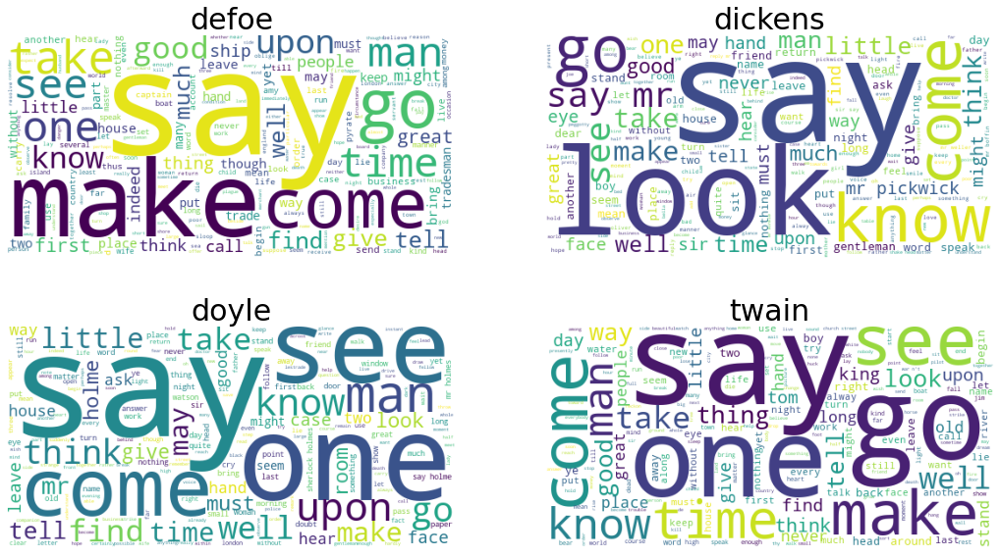

In [12]:
# Concatenate all texts for each author and generate a wordcloud
df_concat_texts_author = df_tr_ev.groupby('author')['text_processed'].apply(lambda l: ' '.join(l)).to_frame()

# Generate a wordcloud
from wordcloud import WordCloud
wc = WordCloud(scale=1.3, background_color="white")
df_concat_texts_author['wordcloud'] = df_concat_texts_author['text_processed'].apply(lambda txt: wc.generate(txt).to_image())

# Plot wordclouds
from author_classification.plot import plot_wordclouds
plot_wordclouds(list(df_concat_texts_author['wordcloud'].items()))

### Word frequency histograms

A word frequency histogram per author can let us dig down into the specific word count for each author and each word, apart from comparing easily their distributions between authors

In [13]:
df_concat_texts_author['hist_most_common'] = df_concat_texts_author['text_processed'].apply(
    lambda txt: plot_most_common_words_freq(most_common_words(txt))
)

from author_classification.plot import plot_vertical_histograms_sidebyside
plot_vertical_histograms_sidebyside(list(df_concat_texts_author['hist_most_common'].items()))

**Looks like there are a lot of words that are the most common for all authors.**

Therefore, the analysis should be redone after removing the most common words globally





_Also note_: After the heavy text processing, some texts can still have some `'n` tokens. This is intended, as it's the result of tokenizing contracted words that were not the usual ones found in `author_classification.preprocessing.DICT_CONTRACTIONS`.

This happens because of how the author writes some verbs with past tense. Therefore, it can be especially useful to keep track of these forms, especially to detect this style, and therefore correctly categorize the author

## Word frequency per author after removing global most common words

In [14]:
from nltk.tokenize import word_tokenize
df_concat_texts_author['text_processed_wo_most_common_global'] = df_concat_texts_author['text_processed'].apply(
    lambda txt: ' '.join([w for w in word_tokenize(txt) if w not in most_common_global_words])
)
df_concat_texts_author['wordcloud_wo_most_common_global'] = df_concat_texts_author['text_processed_wo_most_common_global'].apply(lambda txt: wc.generate(txt).to_image())

### Wordcloud

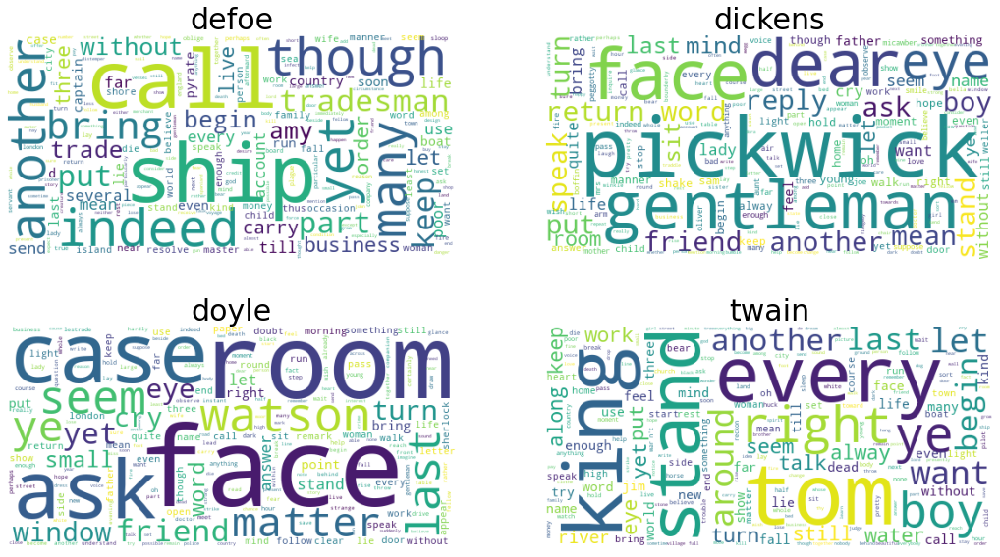

In [15]:
plot_wordclouds(list(df_concat_texts_author['wordcloud_wo_most_common_global'].items()))

Now we can really see some interesting common words for each author. For example:
- "_Holmes_", "_Watson_", "_room_" for Doyle (from Sherlock holmes) and more related words of crime scene investigation ("_face_", "_window_", "_look_", "_case_", ...)
- "_Tom_" for Twain (from Tom Sawyer)
- "_Ship_", "_tradesman_" for Defoe (from Robinson Crusoe)

### Word frequency histograms

In [16]:
# Plot again without globally common words
df_concat_texts_author['hist_most_common_wo_most_common_global'] = df_concat_texts_author['text_processed_wo_most_common_global'].apply(
    lambda txt: plot_most_common_words_freq(most_common_words(txt), height=1000, width=300)
)

plot_vertical_histograms_sidebyside(list(df_concat_texts_author['hist_most_common_wo_most_common_global'].items()))

Also, it might be interesting to see the most frequent bigrams, to see the clearest dependencies between the words for each author

### Bigram frequency histograms

In [17]:
# Calculate bigrams of texts
from nltk.util import ngrams
df_concat_texts_author['text_processed_tokens'] = df_concat_texts_author['text_processed'].apply(word_tokenize)

df_concat_texts_author['text_processed_bigrams'] = df_concat_texts_author['text_processed_tokens'].apply(
    lambda l: [' '.join(x) for x in list(ngrams(l, 2))]
)

# Select top frequent bigrams
from collections import Counter
from author_classification.lexical_analysis import NUM_TOP_WORDS
df_concat_texts_author['top_freq_bigrams'] = df_concat_texts_author['text_processed_bigrams'].apply(
    lambda l: Counter(l).most_common(NUM_TOP_WORDS)
)

df_concat_texts_author['top_freq_bigrams_hist'] = df_concat_texts_author['top_freq_bigrams'].apply(plot_most_common_words_freq)

# Plot
plot_vertical_histograms_sidebyside(list(df_concat_texts_author['top_freq_bigrams_hist'].items()))

With this analysis we see how important is to take into account bigrams when classifying texts, because 1-grams themselves don't capture relationships that we can clearly see for each author. For example:
- **Twain** mentions a lot of times "_old man_" while the word "_man_" is more likely to be used by other authors too.
- Also, **Twain** mentions a lot of times "_New Orleans_" while obviously "_new_" on its own has a different usage meaning.
- We can see how many different "_Mr. X_" **Dickens** mentions, while in the 1-gram analysis we could only see "_Mr._"


# Punctuation analysis

Some authors might be more prone to use some certain punctuations. Some writing styles also rely more on contractions, so we will analyse the statistics related to the usage of these, per author.

In [18]:
# Set punctuation features (statistics) from original texts
from author_classification.feature_extraction import get_text_punctuation_stat_features
df_tr_ev['dict_punct_features'] = df_tr_ev['text'].progress_apply(get_text_punctuation_stat_features)

punctuation_feature_names = df_tr_ev['dict_punct_features'].iloc[0].keys()

# Put each punctuation feature in a column in the dataframe
from author_classification.utils import expand_col_dicts
df_tr_ev = expand_col_dicts(df_tr_ev, colname_dict='dict_punct_features')

100%|██████████| 40000/40000 [00:09<00:00, 4432.24it/s]


In [19]:
from plotly.subplots import make_subplots
from math import ceil

df_punctstats_per_author = df_tr_ev.groupby('author').agg({feature_name:list for feature_name in punctuation_feature_names})

num_row_plots = ceil(len(df_punctstats_per_author.columns)/2)
num_col_plots = 3
fig = make_subplots(
    rows=num_row_plots,
    cols=num_col_plots,
    subplot_titles=([statname for statname in df_punctstats_per_author.columns]),
    vertical_spacing=0.05
)


idx = 0
for i in range(1, num_row_plots+1):
    for j in range(1, num_col_plots+1):
        if idx == len(df_punctstats_per_author.columns):
            break
        statname = df_punctstats_per_author.columns[idx]
        subfig = px.box(
            df_punctstats_per_author.reset_index().explode(statname),
            y=statname,
            x='author',
#             height=800,
            points=False # Don't show outliers so we see the boxes better (unsquashed)
        )
#         subfig.show()
        assert len(subfig.data) == 1
        fig.add_trace(
            subfig.data[0],
            row=i, col=j
        )


        idx += 1
fig.update_layout(height=3500, width=1200, title_text="Punctuation statistics per author")
fig.show()

## Interesting insights
- Dickens has more tendency to use apostrophes (`’ ‘ ‛ ❛ ❜ ❟`) in his text fragments, with a median of 2 apostrophes per text fragment (vs 0 for Defoe and Twain, and 1 for Doyle)
- In general, Dickens and Doyle write more quotes (`« » ‹ › „ “ ‟ ” ’ " ❝ ❞ ❮ ❯ ⹂ 〝 〞 〟 ＂`) per text fragments, because their median quotes is 2, while it is 0 for Defoe and Twain.
- Defoe is more likely to use pausing punctuation (`, ; :`) than others, with a median of 8 and IQR of 6 (5 to 11), vs:
    - Dickens' median: 5 IQR of 3 (4 to 7)
    - Doyle's median: 3 IQR of 3 (2 to 5)
    - Twain' median: 4 IQR of 3 (3 to 6)

# Topic modelling

Apart from analyzing the plain frequency of words throughout the entire authors' texts, it might also be interesting and insightful to do Topic Modelling.

Topic Modelling might be especially helpful if we have different books/stories/worlds for each author, because it:

1. Analyses how likely are words to appear together in the same passage/blob, and
2. Also "clusterizes" these topics, and it shows the different ones within the space of the author

In [20]:
from author_classification.topic_modelling import generate_topic_models, plot_topic_models
d_ret_topic_modeling = generate_topic_models(df_tr_ev, colname_text='text_processed', num_topics=50, bigrams=False)

In [21]:
plot_topic_models(d_ret_topic_modeling)

/usr/local/lib/python3.7/dist-packages/pyLDAvis/_prepare.py:248: FutureWarning:

In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only



## Insights and conclusions

The further the bubbles are away from each other, the more different the topics are.
The larger the bubble, the more frequent is the topic in the documents.

Therefore, we with this topic analysis, we conclude that:

- High importance words (λ=1) are also the most used ones, especially in topics clustered together
- If we bring down the word importance parameter (λ) to 0.5, we can see how some topics contents gain clearance, as the displayed words become more exclusive for that topic in particular. For example, for topic 2, we can see some words like "_water_", "_river_", "_spring_", "_smoke_", "_wood_", "_log_", etc. which are related to each other. Probably this topic captures text fragments that are explaining some scenes in a forest with a river, or in the nature.
- However, In general, all topics seem to be quite clustered together, which makes sense because it is very likely for all these text fragments to have the same important words (these are the most frequent verbs and forms: would, go, see say, come, etc.). Therefore, this shows that it will be difficult to caracterize the texts in classes only their pure word content. **This is important to not rely only in word-gram based features**.

# Sentiment and readability analysis

After the lexical analysis, let's also analyze semantic aspects of the texts, like polarity and subjectivity.

We will also use readability formulas to assess how hard to read each text is. We will use these values as features. These formulas are:

- [Flesch Reading Ease](https://en.wikipedia.org/wiki/Flesch%E2%80%93Kincaid_readability_tests#Flesch_reading_ease): Higher scores indicate material that is easier to read; lower numbers mark passages that are more difficult to read.

The next scores are obtained from different formulas. All of them try to adjust the returned value to the best estimate of the years of formal education a person needs to understand the text on the first reading.
- [Flesch Kincaid Grade](https://en.wikipedia.org/wiki/Flesch%E2%80%93Kincaid_readability_tests#Flesch%E2%80%93Kincaid_grade_level)
- [The Fog Scale (Gunning FOG Formula)](https://en.wikipedia.org/wiki/Gunning_fog_index)
- [Automated Readability Index](https://en.wikipedia.org/wiki/Automated_readability_index)
- [The Coleman-Liau Index](https://en.wikipedia.org/wiki/Coleman%E2%80%93Liau_index)
- [Linsear Write Formula](https://en.wikipedia.org/wiki/Linsear_Write)
- [Dale-Chall Readability Score](https://en.wikipedia.org/wiki/Dale%E2%80%93Chall_readability_formula)

Also, we will also calculate these other indices and values for each of the texts:
- [McAlpine EFLAW Readability Score](https://strainindex.wordpress.com/2009/04/30/mcalpine-eflaw-readability-score/): Returns a score for the readability of an english text for a foreign learner or English, focusing on the number of miniwords and length of sentences.
- **Reading Time**: Reading time time of the given text. Assumes 14.69ms per character. Based on the study of _V. Demberg and F. Keller 2008 "Data from Eye-tracking Corpora as Evidence for Theories of Syntactic Processing Complexity"_
- **Syllable Count**: Number of syllables present in the given text.
- **Lexicon Count**: Number of words present in the text.
- **Char Count**: Number of characters present in the given text, ignoring spaces.
- **Letter Count**: Number of characters present in the given text without punctuation.
- **Polysyllab Count**: Number of words with a syllable count greater than or equal to 3.
- **Monosyllab Count**: Number of words with a syllable count equal to one.

In [23]:
from author_classification.feature_extraction import (
    set_text_readability_statistics, set_text_polarity_subjectivity, LIST_TUPLES_READABILITY_STATISTICS
)
df_tr_ev = set_text_readability_statistics(df_tr_ev, colname_text='text')
df_tr_ev = set_text_polarity_subjectivity(df_tr_ev, colname_text='text')

100%|██████████| 40000/40000 [00:16<00:00, 2456.21it/s]


In [24]:
df_measures_per_author = df_tr_ev.groupby('author').agg(
    {
        **{'polarity': list, 'subjectivity': list},
        **{k:list for k in list(zip(*LIST_TUPLES_READABILITY_STATISTICS))[0]}
    }
)

## Table with mean readablity and sentiment indices per author

In [25]:
df_measures_per_author.applymap(np.mean)

,polarity,subjectivity,flesch_reading_ease,flesch_kincaid_grade,gunning_fog,automated_readability_index,coleman_liau_index,linsear_write_formula,dale_chall_readability_score,mcalpine_eflaw,reading_time,syllable_count,lexicon_count,char_count,letter_count,polysyllabcount,monosyllabcount
author,,,,,,,,,,,,,,,,,
defoe,0.093046,0.093046,41.324794,21.28920,24.107359,26.76735,7.620036,28.776799,9.394691,81.53586,4.732209,96.0404,74.5767,322.1394,310.4077,4.4677,58.7449
dickens,0.091512,0.091512,73.411055,8.22065,10.565672,10.57678,7.142361,11.487999,8.655849,30.49424,3.427025,67.8090,51.3347,233.2898,219.6400,3.5074,39.4159
doyle,0.063080,0.063080,78.882545,6.77440,9.186636,8.33762,6.441077,9.748760,7.657182,26.60480,3.046188,61.2100,47.4832,207.3649,198.0895,2.8908,37.4035
twain,0.091341,0.091341,71.755769,9.50303,11.880296,12.14201,7.228143,13.534590,8.214265,36.60834,3.657252,72.4259,56.1171,248.9630,238.0940,3.2701,44.0409


At a first glance, we see that some of these indices might be very useful to help distinguish texts from different authors.

For example, we can see that the mean `flesch_reading_ease` for Defoe is much lower than the other authors.

Also, other metrics that show text length indicate that Defoe's text fragments are generally longer

## Distribution of readablity and sentiment indices per author

With a more fine-grained plot of how these indices are distributed we can see which ones will likely be more useful to distinguish the texts' authors, and also we can assess how different one author might be from the others

In [26]:
from plotly.subplots import make_subplots
from math import ceil

num_row_plots = ceil(len(df_measures_per_author.columns)/2)
num_col_plots = 3
fig = make_subplots(
    rows=num_row_plots,
    cols=num_col_plots,
    subplot_titles=([statname for statname in df_measures_per_author.columns]),
    vertical_spacing=0.05
)


idx = 0
for i in range(1, num_row_plots+1):
    for j in range(1, num_col_plots+1):
        if idx == len(df_measures_per_author.columns):
            break
        statname = df_measures_per_author.columns[idx]
        subfig = px.box(
            df_measures_per_author.reset_index().explode(statname),
            y=statname,
            x='author',
#             height=800,
            points=False # Don't show outliers so we see the boxes better (unsquashed)
        )
#         subfig.show()
        assert len(subfig.data) == 1
        fig.add_trace(
            subfig.data[0],
            row=i, col=j
        )


        idx += 1
fig.update_layout(height=3500, width=1200, title_text="Statistics per author")
fig.show()

/usr/local/lib/python3.7/dist-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/usr/local/lib/python3.7/dist-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/usr/local/lib/python3.7/dist-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/usr/local/lib/python3.7/dist-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload


## Sentiment and reading-difficutly analysis conclusions
- All 4 authors have the same `polarity` and `subjectivity` in average
- Most readability metrics support that __Defoe__ is the hardest author to understand when reading (they show high necessary grade overall to understand his texts).
    - For example, his median `flesch_readability_score` is clearly the lowest with a value of `47.8` vs `86.4` (dickens), `80.92` (doyle) and `86.33` (twain)
    - In overall, looks like reading difficulty is `Defoe > Dickens = Twain > Doyle`
- Most writing-style-related analysis like `reading-time`, `lexicon-count`, `syllable-count`, `monosyllable-count`, `pollysylable-count`, etc. show a slight tendence of __Doyle__ over the other authors to write shorter, faster to read text pieces, which is probably the reason why his texts show a slightly higher readability scores.